# AGH Modelling of Physical Systems Lab 6 (2025 April 15th)
Tomasz Makowski

**0. Key concepts:**
- [Coagulation](https://en.wikipedia.org/wiki/Coagulation_&#40;disambiguation&#41;) - growth of particles through aggregation
- [Smoluchowski coagulation equation (SCE)](https://en.wikipedia.org/wiki/Smoluchowski_coagulation_equation) - deterministic mathematical model
- [Golovin's analytic solution to SCE](http://mi.mathnet.ru/dan27630) for additive kernel and exponential initial condition
- [Super-Droplet Method Monte-Carlo algorithm](https://arxiv.org/abs/physics/0701103) by Shima et al. 2007 ([patent in 2006](https://patents.google.com/patent/EP1847939A3))

**1. particle-resolved random-sampled state representation for a mass-controled coagulation problem**

In [162]:
""" targetting 100% nbqa-pylint clean code! :) """

from types import SimpleNamespace
from dataclasses import dataclass
from typing import Any, Callable
from copy import deepcopy
import time
from functools import partial
import numpy as np
import scipy
from matplotlib import pyplot
from open_atmos_jupyter_utils import show_plot
import numba

In [163]:
PARAMS_PHYS = SimpleNamespace(
    n0=2**20,
    dv_m3 = 1e7,
    x0_kg=1.192e-13,
    b_per_s = 1500,
)
PARAMS_PHYS.dist = scipy.stats.expon(loc=0, scale=PARAMS_PHYS.x0_kg)
PARAMS_PHYS.norm = PARAMS_PHYS.n0 * PARAMS_PHYS.dv_m3

PARAMS_COMP = SimpleNamespace(
    n_part = 2**11,
    t_max_s = 3600,
    n_step = 1800,
)
PARAMS_COMP.dt_s = PARAMS_COMP.t_max_s / PARAMS_COMP.n_step

PARAMS_BINS = SimpleNamespace(
    min_x = -12,
    max_x = -5,
    count = 70
)

RNG = np.random.default_rng(seed=44)

In [164]:
def sample(*, params_comp, params_phys, rng):
    """ randomly samples a particle population using constant-mult_mass[0]iplicity,
    uniform-mass and uniform-log-mass schemes and returns a dictionary
    of three simulation state, each composed of 'mass' and 'mult' arrays """
    u01 = rng.uniform(0, 1, size=params_comp.n_part)
    uniform_sampling_range = [params_phys.dist.ppf(q) for q in (.001, .999)]
    x_uniform_linx = (
        uniform_sampling_range[0]
        + u01 * (uniform_sampling_range[1] - uniform_sampling_range[0])
    )
    x_uniform_logx = np.exp(
        np.log(uniform_sampling_range[0])
        + u01 * (np.log(uniform_sampling_range[1]) - np.log(uniform_sampling_range[0]))
    )
    return {
        k: {
            'mass': v['x'],
            'mult': np.round(v['y'] * params_phys.norm).astype(int),
        }
        for k,v in
        {
            'sampling: uniform random in x': {
                'x': x_uniform_linx,
                'y': params_phys.dist.pdf(x_uniform_linx) \
                  * (uniform_sampling_range[1] - uniform_sampling_range[0]) \
                  / params_comp.n_part,
            },
            'sampling: uniform random in ln(x)': {
                'x': x_uniform_logx,
                'y': params_phys.dist.pdf(x_uniform_logx) \
                  * (np.log(uniform_sampling_range[1]) - np.log(uniform_sampling_range[0])) \
                  / (params_comp.n_part / x_uniform_logx),
            },
            'sampling: constant multiplicity': {
                'x': params_phys.dist.ppf(u01),
                'y': np.full(shape=params_comp.n_part, fill_value=1 / params_comp.n_part),
            }
        }.items()
    }

PARTICLES = sample(params_phys=PARAMS_PHYS, params_comp=PARAMS_COMP, rng=RNG)

In [165]:
def x_of_mass(mass):
    """ defines the plot x coordinate as a funciton of particle mass """
    return np.log(mass) / 3

def mass_of_x(coord):
    """ computes mass back from the plot x coordinate """
    return np.exp(3 * coord)

def kernel(mass_1, mass_2, coeff):
    """ additive coagulation kernel """
    return coeff * (mass_1 + mass_2)

def analytic_solution(mass_kg, time_s, params_phys):
    """ Golovin's analytic solution to Smoluchowski coagulation equation 
    for additive kernel and exponential initial condition """
    tau = 1 - np.exp(-params_phys.n0 * params_phys.b_per_s * params_phys.x0_kg * time_s)
    sqrt_tau = np.sqrt(tau)
    return (
        (1 - tau) / (mass_kg * sqrt_tau)
        * scipy.special.ive(1, 2 * mass_kg / params_phys.x0_kg * sqrt_tau)  # pylint: disable=no-member
        * np.exp(-(1 + tau - 2 * sqrt_tau) * mass_kg / params_phys.x0_kg)
    )

In [166]:
@dataclass
class PlotConfig:
    phys: Any
    comp: Any
    bins: Any
    rng: Any
    t_sim: float = 0.0

In [167]:
def plot(particles: dict, config: PlotConfig) -> None:
    """Plots histogram and scatter of particle states with analytic comparison."""
    _, axs = pyplot.subplot_mosaic(
        [['hist'], ['part']],
        figsize=(11, 6),
        sharex=True,
        tight_layout=True,
    )
    scale = config.phys.norm / config.comp.n_part
    for label, data in particles.items():
        axs['hist'].hist(
            x=x_of_mass(data['mass']),
            weights=data['mult'] / config.phys.norm * data['mass'],
            bins=config.bins.count,
            range=(config.bins.min_x, config.bins.max_x),
            label=label,
            alpha=0.666,
            density=True,
        )
        axs['part'].scatter(
            x_of_mass(data['mass']),
            config.rng.uniform(0, 1, config.comp.n_part),
            s=0.25 + 2 * data['mult'] / scale
        )
    lin_x, d_x = np.linspace(config.bins.min_x, config.bins.max_x, 256, retstep=True)
    x_mean = lin_x[:-1] + d_x / 2
    m_mean = mass_of_x(x_mean)
    dn_dm = analytic_solution(mass_kg=m_mean, time_s=config.t_sim, params_phys=config.phys)
    axs['hist'].plot(
        x_mean,
        dn_dm * np.diff(mass_of_x(lin_x)) / np.diff(lin_x) * config.phys.norm * m_mean,
        color='black',
        label='Golovin solution'
    )
    axs['hist'].legend()
    axs['hist'].set_ylabel(r'pdf(x) $\cdot$ mass(x)')
    axs['hist'].set_title(f'time: {config.t_sim:.1f} s')
    axs['hist'].set_xlim(config.bins.min_x, config.bins.max_x)
    axs['part'].set_xlabel(r'$x = ln(\sqrt[3]{m})$')
    axs['part'].set_yticks([])
    axs['part'].set_ylim(0, 1)
    for axes in axs.values():
        axes.grid()
    show_plot()


In [168]:
plot(
    particles=PARTICLES,
    config=PlotConfig(
        phys=PARAMS_PHYS,
        comp=PARAMS_COMP,
        bins=PARAMS_BINS,
        rng=RNG,
        t_sim=1e-5
    )
)

**2. Monte-Carlo representation of coagulation dynamics**

In [169]:
@dataclass
class SDMParams:
    mult: np.ndarray
    mass: np.ndarray
    kern: Callable[[float, float], float]
    dt: float
    dv: float


def sdm(pairs: np.ndarray, u01: np.ndarray, config: SDMParams) -> None:
    """Monte Carlo coagulation using the SDM method."""
    n = len(config.mult)
    norm_factor = n * (n - 1) / (2 * len(pairs))

    for idx, (i, j) in enumerate(pairs):
        if config.mult[j] > config.mult[i]:
            i, j = j, i

        rate = config.kern(config.mass[i], config.mass[j])
        probability = rate * (config.dt / config.dv) * config.mult[i] * norm_factor

        if probability > u01[idx]:
            if config.mult[i] != config.mult[j]:
                config.mult[i] -= config.mult[j]
                config.mass[j] += config.mass[i]
            else:
                config.mass[j] += config.mass[i]
                config.mass[i] = config.mass[j]
                config.mult[i] = config.mult[j] // 2
                config.mult[j] -= config.mult[i]

In [170]:
def simulate(*, params_phys, params_comp, particles, rng):
    """ does simulation for all sampling variants (each variant using the same shuffled numbers) """
    n_pairs = params_comp.n_part // 2
    kern = partial(kernel, coeff=params_phys.b_per_s)
    for _ in range(params_comp.n_step):
        non_overlapping_pairs = rng.permutation(params_comp.n_part)[: 2 * n_pairs].reshape(-1, 2)
        u01 = rng.uniform(0, 1, n_pairs)
        for part in particles.values():
            sdm(
                pairs=non_overlapping_pairs,
                u01=u01,
                config=SDMParams(
                    mult=part['mult'],
                    mass=part['mass'],
                    kern=kern,
                    dt=params_comp.dt_s,
                    dv=params_phys.dv_m3,
                )
            )

simulate(particles=PARTICLES, params_phys=PARAMS_PHYS, params_comp=PARAMS_COMP, rng=RNG)

In [171]:
plot(
    particles=PARTICLES,
    config=PlotConfig(
        phys=PARAMS_PHYS,
        comp=PARAMS_COMP,
        bins=PARAMS_BINS,
        rng=RNG,
        t_sim=PARAMS_COMP.t_max_s
    )
)

#### Parallel

In [172]:
@numba.njit
def additive_kernel(m1, m2, coeff):
    """Computes the additive coagulation kernel for two particle masses.
    """
    return coeff * (m1 + m2)

In [173]:
@numba.njit(parallel=True)
def perform_coagulation(pair_indices, random_thresholds, other_args: tuple):
    """
    Performs coagulation of particles based on the given parameters.
    """
    mult = other_args[0]
    mass = other_args[1]
    time_step = other_args[2]
    volume = other_args[3]
    rate_coeff = other_args[4]

    total_particles = len(mult)
    normalization = total_particles * (total_particles - 1) / (2 * len(pair_indices))

    for i in numba.prange(len(pair_indices)):
        idx1, idx2 = pair_indices[i]
        if mult[idx1] < mult[idx2]:
            idx1, idx2 = idx2, idx1

        prob = (
            mult[idx1]
            * normalization
            * additive_kernel(mass[idx1], mass[idx2], rate_coeff)
            * time_step
            / volume
        )

        if prob > random_thresholds[i]:
            num_events = int(prob)
            if num_events > 0:
                max_events = mult[idx1] // mult[idx2]
                events = min(num_events, max_events)
                if mult[idx1] - events * mult[idx2] > 0:
                    mult[idx1] -= events * mult[idx2]
                    mass[idx2] += events * mass[idx1]
                else:
                    half = mult[idx2] // 2
                    mult[idx1] = half
                    mult[idx2] -= half
                    mass[idx2] += mass[idx1]
                    mass[idx1] = mass[idx2]

In [179]:
def run_simulation(config_phys, config_comp, particles, generator):
    """
    Run the simulation for coagulation of particles using a generator.
    """
    num_pairs = config_comp.n_part // 2
    for _ in range(config_comp.n_step):
        reshuffled = generator.permutation(config_comp.n_part)[: 2 * num_pairs].reshape(-1, 2)
        thresholds = generator.uniform(0.0, 1.0, num_pairs)

        for particle_group in particles.values():
            perform_coagulation(
                pair_indices=reshuffled,
                random_thresholds=thresholds,
                other_args=(
                    particle_group['mult'],
                    particle_group['mass'],
                    config_comp.dt_s,
                    config_phys.dv_m3,
                    config_phys.b_per_s,
                )
            )


In [180]:
def evaluate_scaling(start_pow, end_pow, runner_func):
    """
    Evaluates the scaling of the simulation time with respect to the number of particles.
    """
    durations = []
    for power in range(start_pow, end_pow + 1):
        num_particles = 2 ** power
        steps = 2 ** (end_pow - start_pow)

        params = SimpleNamespace(n_part=num_particles, t_max_s=3600, n_step=steps)
        params.dt_s = params.t_max_s / steps

        state = sample(params_phys=PARAMS_PHYS, params_comp=params, rng=RNG)

        t_start = time.time()

        runner_func(
            config_phys=PARAMS_PHYS,
            config_comp=params,
            particles=state,
            generator=RNG
        )

        durations.append(time.time() - t_start)

    return durations

In [181]:
def compare_states(state_a, state_b):
    """
    Compares two states of particles to check if they are equal.
    """
    for key in state_a:
        if not np.array_equal(state_a[key]["mass"], state_b[key]["mass"]):
            return False
        if not np.array_equal(state_a[key]["mult"], state_b[key]["mult"]):
            return False
    return True

In [182]:
ALT_PARTICLES = deepcopy(PARTICLES)

rng_a = deepcopy(RNG)
rng_b = deepcopy(RNG)

In [183]:
run_simulation(PARAMS_PHYS, PARAMS_COMP, PARTICLES, rng_a)
run_simulation(PARAMS_PHYS, PARAMS_COMP, ALT_PARTICLES, rng_b)

In [184]:
plot(
    particles=PARTICLES,
    config=PlotConfig(
        phys=PARAMS_PHYS,
        comp=PARAMS_COMP,
        bins=PARAMS_BINS,
        rng=RNG,
        t_sim=PARAMS_COMP.t_max_s
    )
)

In [185]:
plot(
    particles=PARTICLES,
    config=PlotConfig(
        phys=PARAMS_PHYS,
        comp=PARAMS_COMP,
        bins=PARAMS_BINS,
        rng=RNG,
        t_sim=PARAMS_COMP.t_max_s
    )
)

In [186]:
plot(
    particles=ALT_PARTICLES,
    config=PlotConfig(
        phys=PARAMS_PHYS,
        comp=PARAMS_COMP,
        bins=PARAMS_BINS,
        rng=RNG,
        t_sim=PARAMS_COMP.t_max_s
    )
)

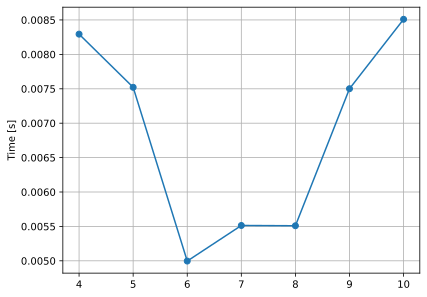

In [187]:
times = evaluate_scaling(4, 10, run_simulation)
pyplot.plot(np.arange(4, 11), times, marker="o", label="SDM-refactored")
pyplot.grid()
pyplot.ylabel("Time [s]")
show_plot()

In [188]:
print(f"Identical Particles: {compare_states(PARTICLES, ALT_PARTICLES)}")

Identical Particles: True


#### Conclusion

The refactored SDM implementation achieves identical results to the original version, as confirmed by the True outcome of the bitwise particle comparison. Performance scaling demonstrates stable simulation times across increasing particle counts, with no significant degradation observed. Visual results, including the Golovin benchmark match, validate the numerical accuracy and statistical behavior of the updated code.